In [1]:
import os
print(os.getcwd())
import pandas as pd
import numpy as np
import json
import re
import matplotlib.pyplot as plt

from bertopic import BERTopic

/root/work


/root/miniconda3/envs/devenv/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/root/miniconda3/envs/devenv/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/root/miniconda3/envs/devenv/lib/python3.9/site-packages/umap/distances.py:1086: Num

In [2]:
from wordcloud import WordCloud, STOPWORDS
from keybert import KeyBERT

In [3]:
!ls /root/projects/PythonProjects/ip-dual-encoder-factorization-machine/data/input/

ads-50k-events.csv  ads-50k.json


# Ads data

In [4]:
file_ads = '/root/projects/PythonProjects/ip-dual-encoder-factorization-machine/data/input/ads-50k.json'
df_ads = pd.read_json(file_ads, lines=True)

In [5]:
df_ads

,id,title,abstract,content,metadata
0,38915469,Recruitment Consultant,We are looking for someone to focus purely on ...,<HTML><p>Are you looking to join a thriving bu...,{'standout': {'bullet1': 'Join a Sector that i...
1,38934839,Computers Salesperson - Coburg,Passionate about exceptional customer service?...,<HTML><p>&middot;&nbsp;&nbsp;Casual hours as r...,{'additionalSalaryText': 'Attractive Commissio...
2,38946054,Senior Developer | SA,Readifarians are known for discovering the lat...,<HTML><p>Readify helps organizations innovate ...,"{'standout': {'bullet1': 'Design, develop, tes..."
3,38833950,Senior Commercial Property Manager | Leading T...,~ Rare opportunity for a Senior PM to step int...,<HTML><p><strong>WayPoint Recruitment&nbsp;</s...,{'additionalSalaryText': '$140k + Car Park - C...
4,38856271,Technology Manager | Travel Industry,Rare opportunity for an experienced Technology...,<HTML>This is a key role within a market leadi...,{'standout': {'bullet1': 'Lead overarching str...
...,...,...,...,...,...
49995,38836927,Data Analyst,"Data Analyst with Adobe Suite, Analytics and T...",<HTML><strong>The Company</strong><br> I am wo...,{'classification': {'name': 'Information & Com...
49996,38894517,Regional Coordinator - Goldfields,WAPHA > Health Industry - Planning and commiss...,<HTML><p><strong>About Us</strong></p> <p>WA P...,{'classification': {'name': 'Healthcare & Medi...
49997,38854483,Warehouse Coordinator,Temporary to permanent opportunity with a fant...,"<HTML><div><em>Our client, a Global leader in ...","{'classification': {'name': 'Manufacturing, Tr..."
49998,38905179,Expression of Interest - Civil Labourer,Our clients are looking for an experienced Civ...,<HTML><p><strong>Expression of Interest - Civi...,{'classification': {'name': 'Trades & Services...


In [6]:
df_ads.isna().sum(axis=0)

id          0
title       0
abstract    0
content     0
metadata    0
dtype: int64

In [7]:
df_ads['id'].nunique()

50000

## A job example (#38915469)

In [8]:
df_ads.loc[0,'title']

'Recruitment Consultant'

In [9]:
df_ads.loc[0,'abstract']


'We are looking for someone to focus purely on recruiting Permanent staff within a buoyant Early Childhood Educaton Sector.'

In [10]:
from IPython.display import display, HTML
HTML(df_ads.loc[0,'content'])

In [11]:
df_ads.loc[0,'metadata']

{'standout': {'bullet1': 'Join a Sector that is considered Recession Proof !',
  'bullet2': 'Excellent opportunity  for Career Progression within a Global Organisation',
  'bullet3': 'Make a Diference whilst earning Money and having Fun'},
 'additionalSalaryText': 'commission',
 'classification': {'name': 'Education & Training'},
 'subClassification': {'name': 'Other'},
 'location': {'name': 'Sydney'},
 'workType': {'name': 'Full Time'}}

# metadata

In [12]:
print('All metadata column names:')
{col for metacol in df_ads['metadata'].apply(lambda x:list(x.keys())) for col in metacol}

All metadata column names:


{'additionalSalaryText',
 'area',
 'classification',
 'location',
 'standout',
 'subClassification',
 'suburb',
 'workType'}

In [13]:
# df_ads.apply(lambda x:x['metadata'].get('additionalSalaryText'), axis=1)
# df_ads.apply(lambda x:x['metadata'].get('location').get('name'), axis=1)
# df_ads.apply(lambda x:x['metadata'].get('suburb'), axis=1)
# df_ads.apply(lambda x:x['metadata'].get('area'), axis=1)
# df_ads.apply(lambda x:x['metadata'].get('standout'), axis=1)
# df_ads.apply(lambda x:x['metadata'].get('classification'), axis=1)
# df_ads.apply(lambda x:x['metadata'].get('subClassification'), axis=1)
# df_ads.apply(lambda x:x['metadata']['workType']['name'], axis=1)

### Column `additionalSalaryText`

In [14]:
print('Not using `additionalSalaryText` column since 33000 out of 50000 are None, and the other values are difficult to process at the moment.')
df_ads.apply(lambda x:x['metadata'].get('additionalSalaryText'), axis=1).value_counts(dropna=False)

Not using `additionalSalaryText` column since 33000 out of 50000 are None, and the other values are difficult to process at the moment.


None                                                 33651
$25 - $29.99 per hour                                  143
$25 - $34.99 per hour                                   92
Competitive                                             77
$20 - $24.99 per hour                                   75
                                                     ...  
$73791 - $74791 p.a. + Super                             1
$60k + Bonuses + Progression                             1
To $55K                                                  1
Hourly rate from $32/hr + super + OT + incentives        1
$650 - $700 per day                                      1
Name: count, Length: 10455, dtype: int64

### Column `location`

In [15]:
# df_ads.apply(lambda x:x['metadata'].get('location').get('name'), axis=1).value_counts(dropna=False)
df_ads['location'] = df_ads.apply(lambda x:x['metadata'].get('location').get('name'), axis=1)
df_ads.loc[df_ads['location'].isin(df_ads['location'].value_counts().tail(5).index), 'location'] = '[OTHER]'
df_ads['location'].value_counts(dropna=False)

location
Sydney                                  13215
Melbourne                               10664
Brisbane                                 4323
Auckland                                 3428
Perth                                    2946
                                        ...  
Somerset & Lockyer                         18
London                                     15
Fleurieu Peninsula & Kangaroo Island       12
[OTHER]                                    11
Central & South East TAS                   10
Name: count, Length: 83, dtype: int64

In [20]:
df_ads[['id', 'location']]

,id,location
0,38915469,Sydney
1,38934839,Melbourne
2,38946054,Adelaide
3,38833950,Melbourne
4,38856271,Auckland
...,...,...
49995,38836927,Sydney
49996,38894517,Perth
49997,38854483,Melbourne
49998,38905179,Coffs Harbour & North Coast


In [17]:
print('Not using `suburb` or `area` since `location` already represents similar info. And `suburb` or `area` have more Nones.')
# df_ads.apply(lambda x:x['metadata']['suburb']['name'] if 'suburb' in x['metadata'] else None, axis=1).value_counts(dropna=False)
# df_ads.apply(lambda x:x['metadata']['area']['name'] if 'area' in x['metadata'] else None, axis=1).value_counts(dropna=False)

Not using `suburb` or `area` since `location` already represents similar info. And `suburb` or `area` have more Nones.


In [18]:
print('Not using `standout` column since over 23000 values are None, and other text columns have similar info')
df_ads.apply(lambda x:x['metadata'].get('standout'), axis=1).isna().sum()

Not using `standout` column since over 23000 values are None, and other text columns have similar info


23315

### Column `classification`

In [19]:
# df_ads.apply(lambda x:x['metadata'].get('classification').get('name'), axis=1).value_counts(dropna=False)
df_ads['classification'] = df_ads.apply(lambda x:x['metadata'].get('classification').get('name'), axis=1)
df_ads['classification'].value_counts(dropna=False)

classification
Information & Communication Technology    5235
Trades & Services                         4736
Healthcare & Medical                      4599
Manufacturing, Transport & Logistics      3213
Accounting                                2859
Administration & Office Support           2538
Sales                                     2473
Hospitality & Tourism                     2466
Education & Training                      2337
Construction                              2292
Retail & Consumer Products                1932
Engineering                               1747
Government & Defence                      1710
Mining, Resources & Energy                1434
Community Services & Development          1350
Marketing & Communications                1308
Human Resources & Recruitment             1258
Legal                                     1114
Call Centre & Customer Service            1047
Banking & Financial Services               990
Real Estate & Property                     91

### Column `subClassification`

In [20]:
df_ads['subClassification'] = df_ads.apply(lambda x:x['metadata'].get('subClassification').get('name'), axis=1)
print('Values with less than 10 appearances are assigned as "Other", which is a value already exists.')
df_ads.loc[df_ads['subClassification'].isin(df_ads['subClassification'].value_counts(dropna=False).tail(32).index), 'subClassification'] = 'Other'
df_ads['subClassification'].value_counts(dropna=False)

Values with less than 10 appearances are assigned as "Other", which is a value already exists.


subClassification
Other                                2870
Management                           1618
Administrative Assistants            1131
Developers/Programmers               1072
Sales Representatives/Consultants    1038
                                     ... 
Art Direction                          11
Winery & Viticulture                   11
Oil & Gas - Drilling                   10
Nursing - Paediatric & PICU            10
COO & MD                               10
Name: count, Length: 305, dtype: int64

### Column `workType`

In [21]:
df_ads['workType'] = df_ads.apply(lambda x:x['metadata']['workType']['name'], axis=1)
df_ads['workType'].value_counts(dropna=False)

workType
Full Time          34858
Contract/Temp       8559
Casual/Vacation     3295
Part Time           3288
Name: count, dtype: int64

In [22]:
if 'metadata' in df_ads.columns:
    df_ads = df_ads.drop(columns='metadata')

In [23]:
df_ads

,id,title,abstract,content,location,classification,subClassification,workType
0,38915469,Recruitment Consultant,We are looking for someone to focus purely on ...,<HTML><p>Are you looking to join a thriving bu...,Sydney,Education & Training,Other,Full Time
1,38934839,Computers Salesperson - Coburg,Passionate about exceptional customer service?...,<HTML><p>&middot;&nbsp;&nbsp;Casual hours as r...,Melbourne,Retail & Consumer Products,Retail Assistants,Casual/Vacation
2,38946054,Senior Developer | SA,Readifarians are known for discovering the lat...,<HTML><p>Readify helps organizations innovate ...,Adelaide,Information & Communication Technology,Consultants,Full Time
3,38833950,Senior Commercial Property Manager | Leading T...,~ Rare opportunity for a Senior PM to step int...,<HTML><p><strong>WayPoint Recruitment&nbsp;</s...,Melbourne,Real Estate & Property,"Commercial Sales, Leasing & Property Mgmt",Full Time
4,38856271,Technology Manager | Travel Industry,Rare opportunity for an experienced Technology...,<HTML>This is a key role within a market leadi...,Auckland,Information & Communication Technology,Management,Full Time
...,...,...,...,...,...,...,...,...
49995,38836927,Data Analyst,"Data Analyst with Adobe Suite, Analytics and T...",<HTML><strong>The Company</strong><br> I am wo...,Sydney,Information & Communication Technology,Business/Systems Analysts,Full Time
49996,38894517,Regional Coordinator - Goldfields,WAPHA > Health Industry - Planning and commiss...,<HTML><p><strong>About Us</strong></p> <p>WA P...,Perth,Healthcare & Medical,Other,Full Time
49997,38854483,Warehouse Coordinator,Temporary to permanent opportunity with a fant...,"<HTML><div><em>Our client, a Global leader in ...",Melbourne,"Manufacturing, Transport & Logistics","Warehousing, Storage & Distribution",Full Time
49998,38905179,Expression of Interest - Civil Labourer,Our clients are looking for an experienced Civ...,<HTML><p><strong>Expression of Interest - Civi...,Coffs Harbour & North Coast,Trades & Services,Labourers,Casual/Vacation


# Text analysis

## Regex Text Cleaning

In [24]:
# Removing HTML tags and characters from `content`-----------------------
# https://regex101.com/
# re.sub("<.*?>", " ", df_ads.loc[0,'content']).strip()
df_ads['content'] = df_ads['content'].apply(lambda x: re.sub("<.*?>|\n", " ", x).strip()) # Removing HTML tags, e.g., <HTML>
df_ads['content'] = df_ads['content'].apply(lambda x: re.sub("&[a-zA-Z]*;", " ", x)) # Removing HTML entities,e.g., &rsquo; &nbsp;

df_ads['_content'] = df_ads['content']
df_ads['_title'] = df_ads['title']
df_ads['_abstract'] = df_ads['abstract']

# Removing special characters-----------------------
regex = re.compile(r"[^a-zA-Z0-9\s.,!?""]")
for col in ['_title', '_abstract', '_content']:
    df_ads[col] = df_ads[col].apply(lambda x: regex.sub(', ', x))
    df_ads[col] = df_ads[col].apply(lambda x: re.sub("\s{2,}", " ", x)) # Reducing spaces
    df_ads[col] = df_ads[col].str.lower() # Lower case

In [25]:
df_ads.loc[df_ads['_title'].str.contains(','), '_title']

1                           computers salesperson , coburg
2                                    senior developer , sa
3        senior commercial property manager , leading t...
4                     technology manager , travel industry
7                youth wellbeing worker, headspace pilbara
                               ...                        
49992    qa associate, pharmaceutical, government, sout...
49993    mechanical fitters , boilermakers , riggers , ...
49994                   cloud devops , automation engineer
49996                    regional coordinator , goldfields
49998              expression of interest , civil labourer
Name: _title, Length: 23736, dtype: object

## Unique `title`s

In [27]:
print('Over 35000 unique job titles out of 50000 unique jobs. It cannot be used for categorical embedding. Word embedding is OK.')
df_ads['_title'].value_counts(dropna=False)
# df_ads['title'].value_counts(dropna=False).reset_index(drop=True).plot.line()

Over 35000 unique job titles out of 50000 unique jobs. It cannot be used for categorical embedding. Word embedding is OK.


_title
project manager                                 197
business development manager                    154
registered nurse                                117
business analyst                                105
executive assistant                              96
                                               ... 
subsea equipment specialist                       1
contract caterers required                        1
graduate opportunity , multinational insurer      1
trade, non trade auto electrician                 1
provisioning support                              1
Name: count, Length: 35671, dtype: int64

## Word cloud 1: `title` & `abstract` for 'Information & Communication Technology'

In [28]:
test_classification = 'Information & Communication Technology'
text_title = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_title'])
text_abstract = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_abstract'])

The word cloud for the `title` of the jobs in `Information & Communication Technology`


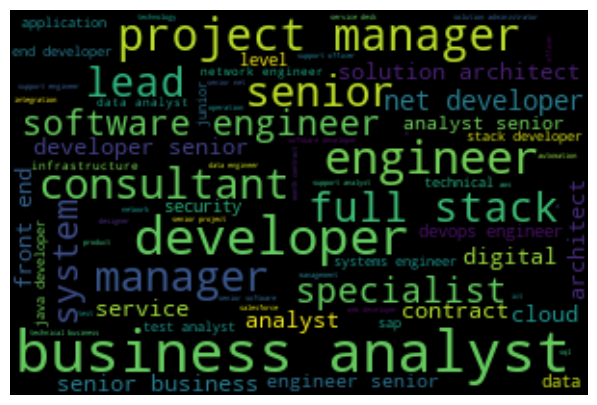

The word cloud for the `abstract` of the jobs in `Information & Communication Technology`


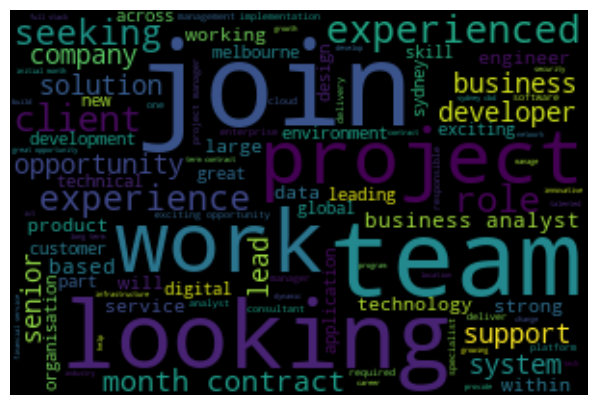

In [29]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

print(f'The word cloud for the `title` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_title)
plt.figure(figsize=(15,5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

print(f'The word cloud for the `abstract` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_abstract)
plt.figure(figsize=(10,5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Word cloud: `title` & `abstract` for 'Engineering'

The word cloud for the `title` of the jobs in `Engineering`


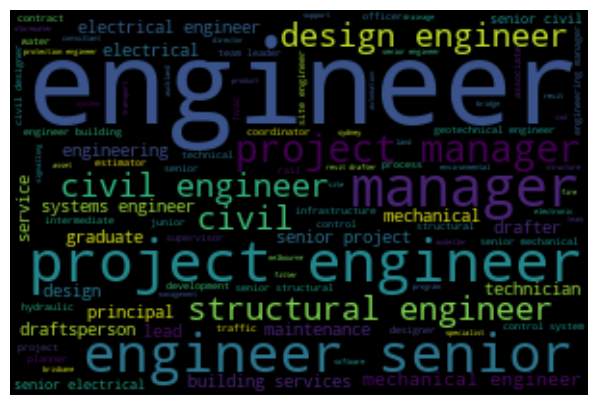

The word cloud for the `abstract` of the jobs in `Engineering`


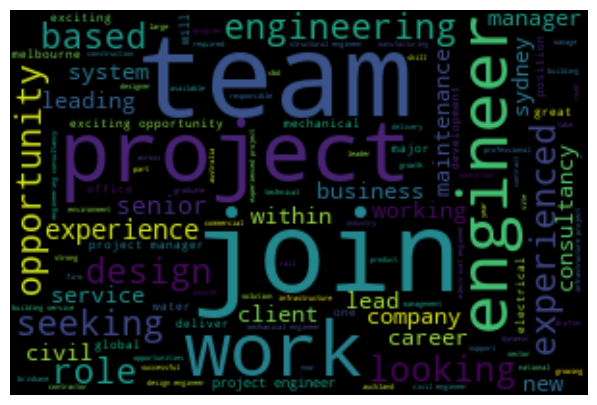

In [30]:
test_classification = 'Engineering'
text_title = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_title'])
text_abstract = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_abstract'])

print(f'The word cloud for the `title` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_title)
plt.figure(figsize=(15,5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

print(f'The word cloud for the `abstract` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_abstract)
plt.figure(figsize=(10,5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Word cloud: `title` & `abstract` for 'Science & Technology'

The word cloud for the `title` of the jobs in `Science & Technology`


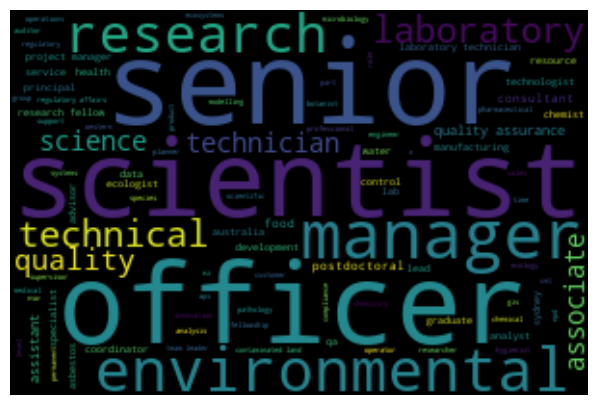

The word cloud for the `abstract` of the jobs in `Science & Technology`


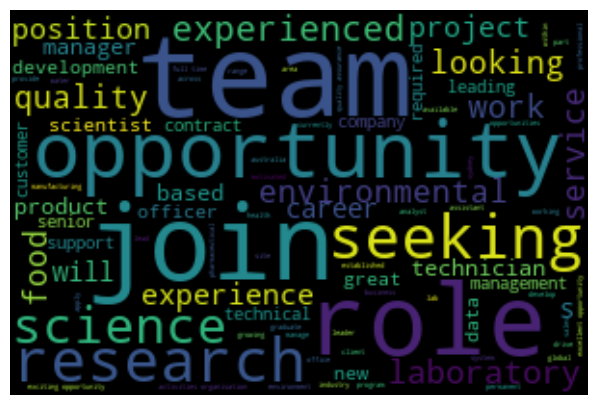

In [31]:
test_classification = 'Science & Technology'
text_title = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_title'])
text_abstract = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_abstract'])

print(f'The word cloud for the `title` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_title)
plt.figure(figsize=(15,5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

print(f'The word cloud for the `abstract` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_abstract)
plt.figure(figsize=(10,5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Word cloud: `title` & `abstract` for 'Sales'

The word cloud for the `title` of the jobs in `Sales`


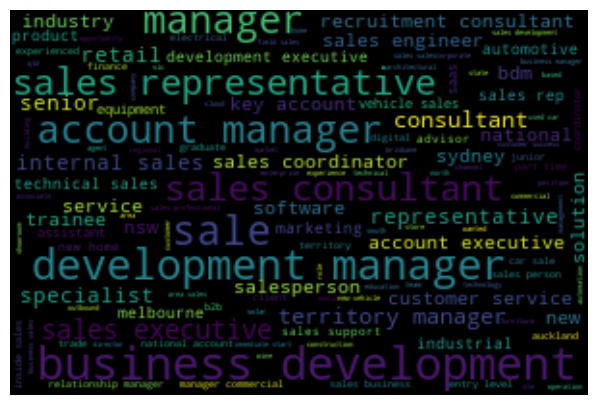

The word cloud for the `abstract` of the jobs in `Sales`


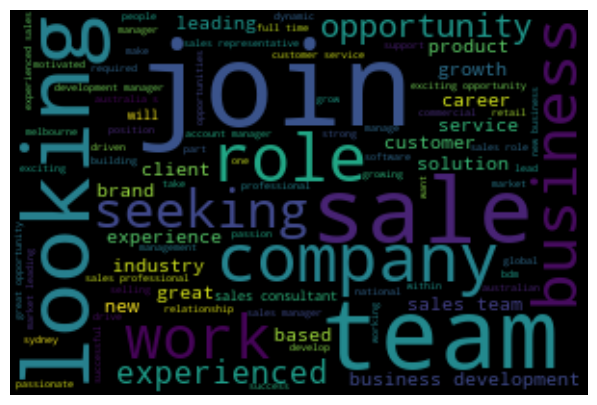

In [32]:
test_classification = 'Sales'
text_title = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_title'])
text_abstract = ' '.join(df_ads.loc[df_ads['classification']==test_classification, '_abstract'])

print(f'The word cloud for the `title` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_title)
plt.figure(figsize=(15,5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

print(f'The word cloud for the `abstract` of the jobs in `{test_classification}`')
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_abstract)
plt.figure(figsize=(10,5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Word cloud with KeyBERT: `content` for 'Science & Technology'

In [33]:
# text_content = ' '.join(df_ads['content'])

In [34]:
# full_text = df_ads['content'].iloc[1]
kw_model = KeyBERT(model='all-mpnet-base-v2')
def get_keywords(full_text):
    keywords = kw_model.extract_keywords(full_text,
                               keyphrase_ngram_range=(1, 1),
                               stop_words='english',
                               highlight=False,
                               top_n=10)
    return list(dict(keywords).keys())

In [35]:
import tqdm

test_classification = 'Information & Communication Technology'
keyword_list = [] #[word for content in df_ads['content'] for word in get_keywords(content)]
for content in tqdm.notebook.tqdm(
        # df_ads['content'].to_list()[:1000]
        df_ads.loc[df_ads['classification']==test_classification, '_content'].to_list() #[:1000]
):
    keyword_list += get_keywords(content)

text_content = ' '.join(keyword_list)

100%|███████████████████████████████████████| 5235/5235 [11:56<00:00,  7.30it/s]


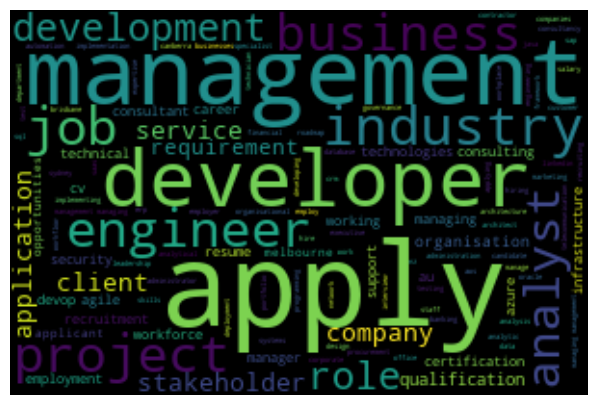

In [36]:
# lower max_font_size
wordcloud = WordCloud(max_font_size=60, width=300, height=200,  random_state=1, stopwords=STOPWORDS).generate(text_content)
plt.figure(figsize=(10,5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Topic extraction with BERTopic from `abstract`

In [37]:
abstracts = df_ads['abstract'].to_list()

Creating topics

In [38]:
bertopic_model = BERTopic(language='english')

In [39]:
topics, probs = bertopic_model.fit_transform(abstracts)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

Most frequent topics

In [40]:
bertopic_model.get_topic_freq()

,Topic,Count
0,-1,19537
11,0,1114
32,1,771
46,2,607
86,3,570
...,...,...
6,541,10
520,542,10
151,543,10
262,544,10


Individual topics

In [41]:
for i in [0, 2, 21]:
    display(bertopic_model.get_topic(i))

[('australian', 0.011206208720612608),
 ('australia', 0.007686711287280584),
 ('australias', 0.007333427347071333),
 ('melbourne', 0.006839109088519645),
 ('sydney', 0.006685418333987538),
 ('iconic', 0.004312381947345267),
 ('sales', 0.003993839465329295),
 ('most', 0.0039694248147136724),
 ('brisbane', 0.003932379723198611),
 ('one', 0.003727443034642375)]

[('sales', 0.028606113768432532),
 ('representative', 0.008625001774022475),
 ('consultant', 0.008454829525483442),
 ('salesperson', 0.00587590681897738),
 ('professional', 0.005338780542391461),
 ('record', 0.005281035861022172),
 ('driven', 0.0049676338290106726),
 ('motivated', 0.004500520188061064),
 ('consultants', 0.00430012932796695),
 ('person', 0.00374644402431922)]

[('enthusiastic', 0.010832934485007483),
 ('player', 0.009913333339771273),
 ('energetic', 0.009674027786894432),
 ('motivated', 0.009673479856104748),
 ('person', 0.009157925012932281),
 ('we', 0.007722608091929292),
 ('individuals', 0.007263574726177144),
 ('who', 0.007171907665941253),
 ('individual', 0.007127476490437368),
 ('looking', 0.006473549626987416)]

Visualizing topics

In [42]:
bertopic_model.visualize_topics()

## Text network

### Top 10 classes with 100 randomly sampled jobs for each

In [45]:
# classes_over_n = df_ads['classification'].value_counts(dropna=False).reset_index().query('classification>=500')['index']
classes_over_n = df_ads['classification'].value_counts(dropna=False).reset_index().query('count>=500').head(10)['classification']

df_ads_text_network = pd.DataFrame()

In [46]:
for cls in classes_over_n:
    df_ads_text_network = pd.concat([
        df_ads_text_network,
        df_ads.loc[df_ads['classification']==cls, ['classification', '_title', '_abstract']].sample(100)
    ])

df_ads_text_network = df_ads_text_network.set_index('classification')
df_ads_text_network.index.value_counts()

classification
Information & Communication Technology    100
Trades & Services                         100
Healthcare & Medical                      100
Manufacturing, Transport & Logistics      100
Accounting                                100
Administration & Office Support           100
Sales                                     100
Hospitality & Tourism                     100
Education & Training                      100
Construction                              100
Name: count, dtype: int64

### Text network: `title`

In [47]:
import textnets as tn
from textnets import Corpus

# !python -m spacy download en_core_web_sm

ModuleNotFoundError: No module named 'textnets'

In [95]:
corpus = Corpus(df_ads_text_network['_title'])
t = tn.Textnet(corpus.tokenized(), min_docs=1)
t

  0%|          | 0/1000 [00:00<?, ?docs/s]

Textnet,Docs: 10,Terms: 1124,Edges: 1722


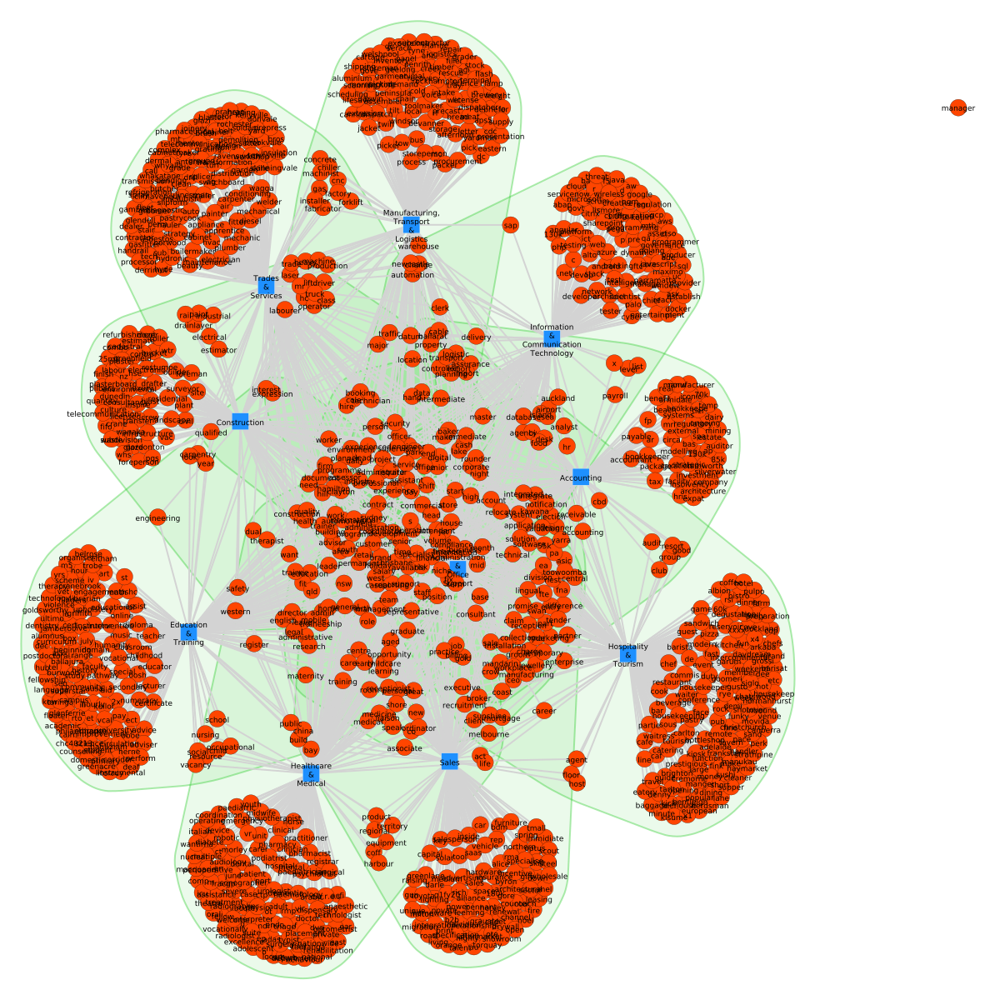

In [96]:
t.plot(label_nodes=True,
       show_clusters=True,
        bbox=(1200, 1200),
       inline=True
       )


### Text network: `abstract`

In [97]:
corpus = Corpus(df_ads_text_network['_abstract'])
t = tn.Textnet(corpus.tokenized(), min_docs=1)
t

  0%|          | 0/1000 [00:00<?, ?docs/s]

Textnet,Docs: 10,Terms: 2412,Edges: 4649


In [98]:
t.plot(label_nodes=True,
       show_clusters=True,
        bbox=(1200, 1200),
       inline=True
       )


# Final data

In [48]:
df_ads = df_ads.rename(columns={'subClassification':'sub_classification', 'workType':'work_type'})

In [49]:
df_ads = df_ads.drop(columns=['_title', '_abstract', '_content'])
df_ads

,id,title,abstract,content,location,classification,sub_classification,work_type
0,38915469,Recruitment Consultant,We are looking for someone to focus purely on ...,Are you looking to join a thriving business th...,Sydney,Education & Training,Other,Full Time
1,38934839,Computers Salesperson - Coburg,Passionate about exceptional customer service?...,Casual hours as required (transition to Par...,Melbourne,Retail & Consumer Products,Retail Assistants,Casual/Vacation
2,38946054,Senior Developer | SA,Readifarians are known for discovering the lat...,Readify helps organizations innovate with tech...,Adelaide,Information & Communication Technology,Consultants,Full Time
3,38833950,Senior Commercial Property Manager | Leading T...,~ Rare opportunity for a Senior PM to step int...,WayPoint Recruitment have partnered up with a...,Melbourne,Real Estate & Property,"Commercial Sales, Leasing & Property Mgmt",Full Time
4,38856271,Technology Manager | Travel Industry,Rare opportunity for an experienced Technology...,This is a key role within a market leading Tra...,Auckland,Information & Communication Technology,Management,Full Time
...,...,...,...,...,...,...,...,...
49995,38836927,Data Analyst,"Data Analyst with Adobe Suite, Analytics and T...",The Company I am working with a highly reput...,Sydney,Information & Communication Technology,Business/Systems Analysts,Full Time
49996,38894517,Regional Coordinator - Goldfields,WAPHA > Health Industry - Planning and commiss...,About Us WA Primary Health Alliance (WAPHA)...,Perth,Healthcare & Medical,Other,Full Time
49997,38854483,Warehouse Coordinator,Temporary to permanent opportunity with a fant...,"Our client, a Global leader in the Healthcare ...",Melbourne,"Manufacturing, Transport & Logistics","Warehousing, Storage & Distribution",Full Time
49998,38905179,Expression of Interest - Civil Labourer,Our clients are looking for an experienced Civ...,Expression of Interest - Civil Labourers ...,Coffs Harbour & North Coast,Trades & Services,Labourers,Casual/Vacation


In [50]:
file_out = '/root/projects/PythonProjects/ip-dual-encoder-factorization-machine/data/input_processed/ads-50k_processed.json'
df_ads.to_json(file_out)

# Summary

1) Judging from a keyword search page on SEEK (https://www.seek.com.au/machine-learning-jobs):
    `title` + `abstract` is for "V" behaviour; `title` + `content` is for "A" behaviour.

2) Discarded `additionalSalaryText` column, since 33000 out of 50000 are None, and the other values are difficult to process at the moment
3) Discarded `suburb` or `area`, since `location` already represents similar info. And `suburb` or `area` have more Nones and are of higher dimensionality
4)
5) Discarded `standout` column since over 23000 values are None, and other text columns have similar info
6) For `location` and `subClassification`, the least frequent values ( e.g., with less than 10 appearances) are assigned as "Other"
7) Majority of `workType` are "Full Time"
8) From the word clouds, for differerent classes (`classification`), `title` of the jobs contain unique words exclusively relevant to the classes of the jobs, while `abstract` also contain some typical common words, such as 'join', 'team', 'role'.
9) The text network analysis for `title` and `abstract` also confirms the above observation.
